In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from concurrent.futures import ThreadPoolExecutor

sns.set_style("ticks")

In [15]:
df_1 = pd.read_parquet("./data/ene2019_1.parquet")
df_2 = pd.read_parquet("./data/ene2019_2.parquet")

df = pd.concat([df_1, df_2], ignore_index=True)

df["Timestamp"] = pd.to_datetime(df["Timestamp"], format="%d-%b-%y %H:%M:%S.%f")

In [16]:
tags = pd.read_excel("./data/columna_tag.xlsx", header=1)

tags = tags.rename(columns={"tag": "Tag"})

df_with_tags = pd.merge(df, tags, on="Tag", how="left")

df_with_tags

,Timestamp,Value,Tag,descripcion,sI/NO
0,2019-01-02 10:53:07.300,0.093750,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN
1,2019-01-02 10:54:37.200,7.226562,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN
2,2019-01-02 10:55:22.300,7.226562,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN
3,2019-01-02 10:56:07.400,10.855469,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN
4,2019-01-02 10:56:52.400,11.250000,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN
...,...,...,...,...,...
6634290,2019-01-31 23:57:43.000,0.000000,P#LE0913_EVBE01,NaN,NaN
6634291,2019-01-31 23:58:13.000,0.000000,P#LE0913_EVBE01,NaN,NaN
6634292,2019-01-31 23:58:43.000,0.000000,P#LE0913_EVBE01,NaN,NaN
6634293,2019-01-31 23:59:13.000,0.000000,P#LE0913_EVBE01,NaN,NaN


In [17]:
machines = df_with_tags.groupby("Tag")

print(f"There are {len(machines)} machines in the data.")

There are 314 machines in the data.


## MACHINE EVOLUTION + % CHANGES

In [18]:
df_with_tags["Change (%)"] = df_with_tags.groupby("Tag")["Value"].pct_change() * 100


df_with_tags["Change (%)"] = df_with_tags["Change (%)"].fillna(0)

In [19]:
df_with_tags

,Timestamp,Value,Tag,descripcion,sI/NO,Change (%)
0,2019-01-02 10:53:07.300,0.093750,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN,0.000000
1,2019-01-02 10:54:37.200,7.226562,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN,7608.333333
2,2019-01-02 10:55:22.300,7.226562,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN,0.000000
3,2019-01-02 10:56:07.400,10.855469,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN,50.216216
4,2019-01-02 10:56:52.400,11.250000,P#LS0313_LTCB72,NIVEL 1 TORTA P45 H0,NaN,3.634401
...,...,...,...,...,...,...
6634290,2019-01-31 23:57:43.000,0.000000,P#LE0913_EVBE01,NaN,NaN,0.000000
6634291,2019-01-31 23:58:13.000,0.000000,P#LE0913_EVBE01,NaN,NaN,0.000000
6634292,2019-01-31 23:58:43.000,0.000000,P#LE0913_EVBE01,NaN,NaN,0.000000
6634293,2019-01-31 23:59:13.000,0.000000,P#LE0913_EVBE01,NaN,NaN,0.000000


Borrar output si es necesario liberar espacio

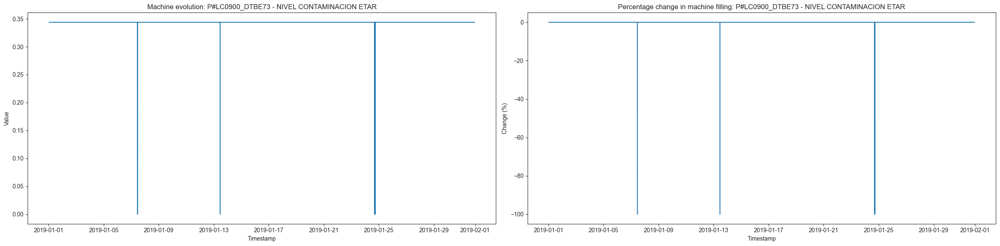

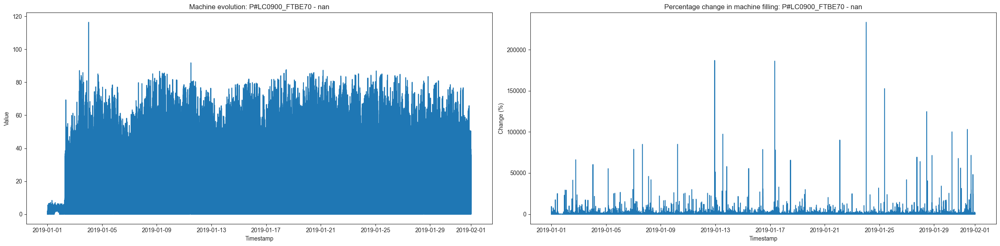

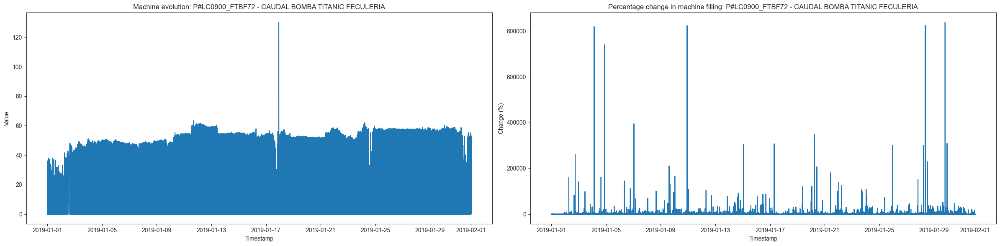

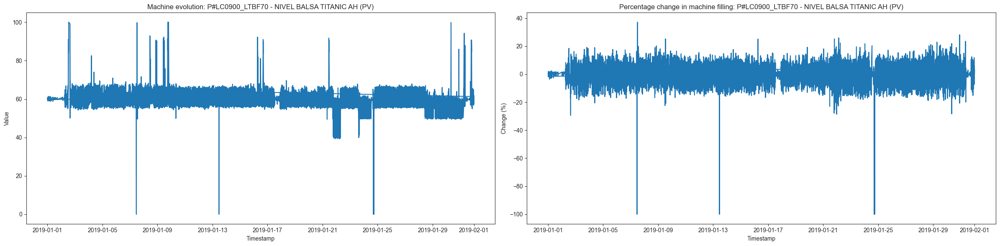

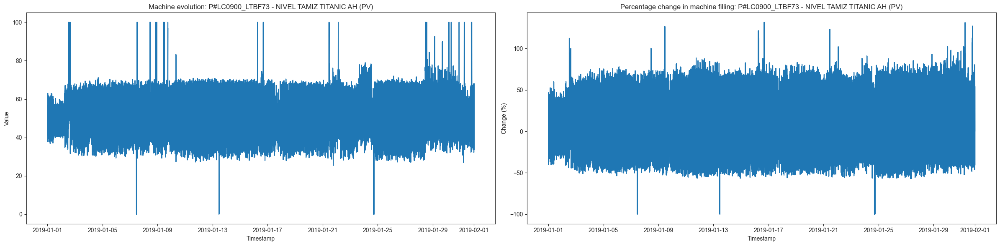

...

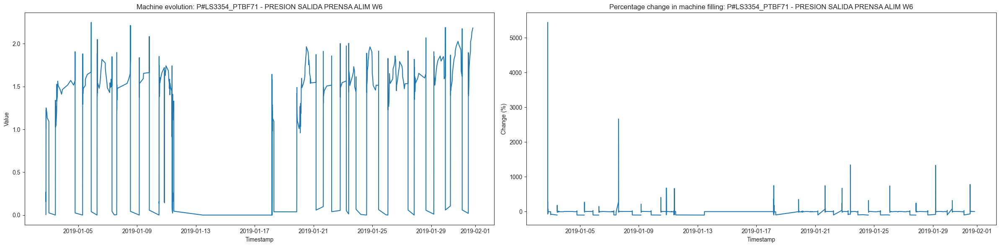

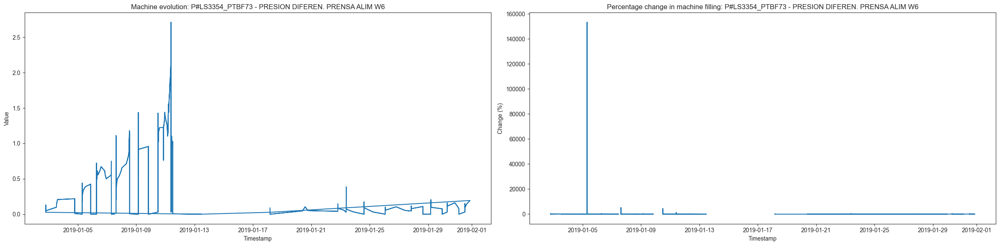

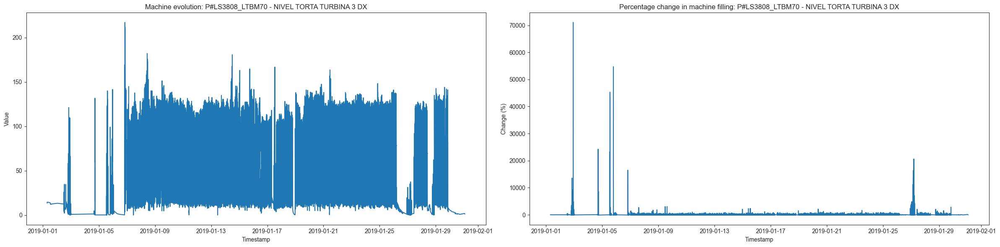

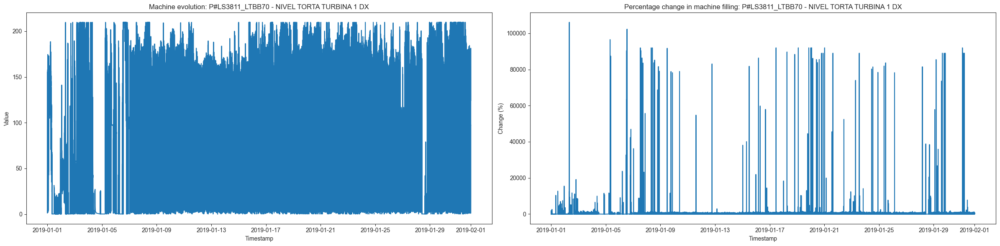

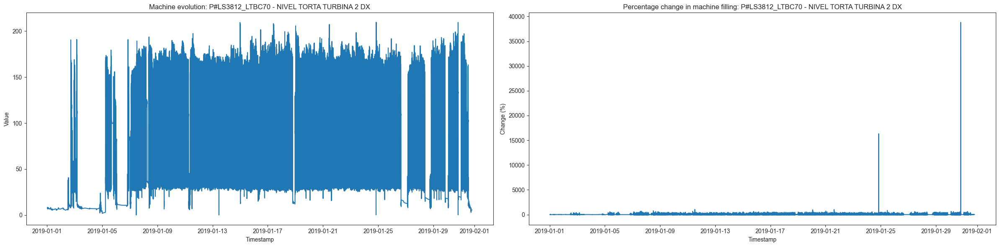

In [20]:
# 3 min

for _, x in machines:
    descripcion = x["descripcion"].iloc[0]
    fig, axs = plt.subplots(1, 2, figsize=(24, 6))

    axs[0].plot(x["Timestamp"], x["Value"])
    axs[0].set_title(f"Machine evolution: {_} - {descripcion}")
    axs[0].set_xlabel("Timestamp")
    axs[0].set_ylabel("Value")

    axs[1].plot(x["Timestamp"], x["Change (%)"])
    axs[1].set_title(f"Percentage change in machine filling: {_} - {descripcion}")
    axs[1].set_xlabel("Timestamp")
    axs[1].set_ylabel("Change (%)")

    plt.tight_layout()
    plt.show()

## NEXT

In [21]:
print("Continuación")

Continuación
